In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")
import folium
from helperfunctions import get_country_specific_information, get_geojson_grid, draw_grid
NY_location, L_location, NY_num, L_num = get_country_specific_information()

In [2]:
data_path = "data/"
places = pd.read_csv(data_path + "places_cleaned.csv")
reviews = pd.read_csv(data_path + "reviews_cleaned.csv")
places.dropna(subset=["category"], inplace=True)

Our project uses the [Google Local](https://cseweb.ucsd.edu/~jmcauley/datasets.html#google_local) data published by Professor Julian McAuley from University of California, San Diego. The data contains reviews about businesses along with their geographical location. The raw data has 3.116.785 businesses and 11.453.845 reviews, which spans across locations all over the world.\

For this project, we wish to focus solely on businesses located in London and Manhattan in NYC, which we have accomplished through preprocessing of the data located in [this notebook](./Data%20Processing.ipynb).

**Write about project purpose and anticipated methods used**

## 1.1 Places

In [3]:
print("Shape of places df:", places.shape)
places.head()

Shape of places df: (29688, 9)


,gPlusPlaceId,name,price,lat,lon,city,address,Grid,category
0,101742583391038750118,Carpo London,NaN,51.509499,-0.135762,London,"16 Piccadilly, London W1J 0DE, United Kingdom",L159,Chocolate Shop
1,100574642292837870712,Premium Cars,NaN,51.514637,-0.064980,London,"10 Commercial Road Premium Cars First Floor, S...",L186,Car Rental Agency
2,105185983265572241970,eSpares Ltd,NaN,51.479416,-0.179209,London,"Chelsea Wharf, 15 Lots Rd, London, Chelsea SW1...",L40,Wholesaler
3,104500852703501308358,Superdrug,NaN,51.494537,-0.145769,London,"Unit 35, Victoria Railway Station, London SW1V...",L101,Beauty Supply Store
4,107519298595557659572,Kura,2.0,51.502122,-0.163029,London,"3-4 Park Close, London SW1X 7PQ, United Kingdom",L137,Asian Restaurant


Here we find a unique `gPlusPlaceId` for each business in the dataset accompanied by other features such as the `name`, `price` range, geographical location,  `Grid` number and business `category`. We have placed a grid over London and Manhattan in order to encapsulate the businesses located there, where the `Grid` feature indicates which grid cell a certain business belongs to.

In [4]:
ny_df = places.loc[places.city =='New York']
grid = get_geojson_grid("New York", n=NY_num-1)
ny_map = draw_grid(grid, NY_location)
for i, row in ny_df.iterrows():
    folium.CircleMarker(location = row[['lat','lon']].values.tolist(), radius=1, fill_color="blue").add_to(ny_map)
ny_map

In [5]:
london_df = places.loc[places.city =='London']
grid = get_geojson_grid("London", n=L_num-1)
london_map = draw_grid(grid, L_location)
for i, row in london_df.iterrows():
    folium.CircleMarker(location = row[['lat','lon']].values.tolist(), radius=1, fill_color="blue").add_to(london_map)
london_map

Through the data preprocessing, many of the missing values in the dataset have been removed with the exception of the ones in the `price` column. This is done since we wish to create a NLP classifier that can enrich the businesses with missing price range in the dataset.

In [6]:
places.isna().sum()

gPlusPlaceId        0
name                0
price           19488
lat                 0
lon                 0
city                0
address             0
Grid                0
category            0
dtype: int64

To dive deeper into our dataset, we'll provide visualizations of the different features

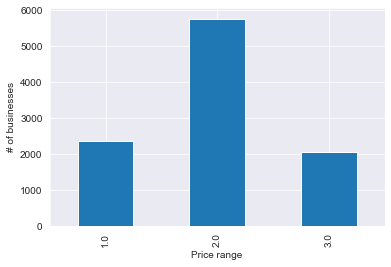

In [7]:
places.price.value_counts().sort_index().plot.bar(ylabel="# of businesses", xlabel="Price range");

In [8]:
places.city.value_counts()

New York    15582
London      14106
Name: city, dtype: int64

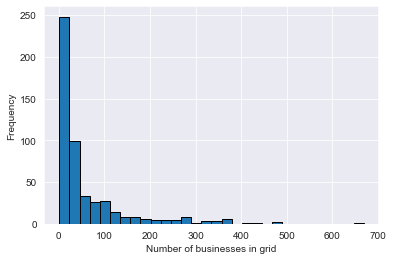

In [9]:
ax = places.Grid.value_counts().plot.hist(bins=30, edgecolor="black");
ax.set_xlabel("Number of businesses in grid");

In [10]:
for city in places.city.unique():
    print(f"Top 5 categories for {city}")
    print(places[lambda x: x['city'] == city].category.value_counts().head(5))
    print()

Top 5 categories for London
European Restaurant    828
Bar                    781
Asian Restaurant       772
Cafe                   731
Pub                    695
Name: category, dtype: int64

Top 5 categories for New York
European Restaurant    799
Asian Restaurant       797
American Restaurant    736
Bar                    499
Clothing Store         470
Name: category, dtype: int64



We can see by the top 5 categories that there are some overlaps between the categories. Perhaps we should clean out the categories (by clustering??)

## 1.2 Reviews

In [11]:
print("Shape of reviews df:", reviews.shape)
reviews.head()

Shape of reviews df: (257122, 6)


,rating,reviewerName,reviewText,gPlusPlaceId,gPlusUserId,reviewTextClean
0,3.0,elicia richardson-ellis,This is a very cute hotel with good amenities ...,106689630448064755324,100000340778638927606,cute hotel good amenity nice location great cr...
1,4.0,elicia richardson-ellis,Love this place. The Great/Good: Massage an...,108256990636148259283,100000340778638927606,love place massage facial technician best loun...
2,4.0,Nakamura Zen,NaN,104395160856690993217,100000469599933991939,NaN
3,4.0,Nakamura Zen,NaN,116090508615311611202,100000469599933991939,NaN
4,5.0,Yordanka Ilieva,Perfect service. The staff were very helpful.,111440664244734940136,100000520090706194742,perfect service staff helpful


In [12]:
reviews.isna().sum()

rating                 0
reviewerName           0
reviewText         69260
gPlusPlaceId           0
gPlusUserId            0
reviewTextClean    69650
dtype: int64

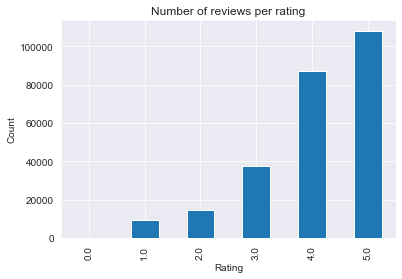

In [13]:
# Fjerne 0 rækker i reviews
reviews.rating.value_counts().sort_index().plot.bar(xlabel="Rating", ylabel="Count", title="Number of reviews per rating");

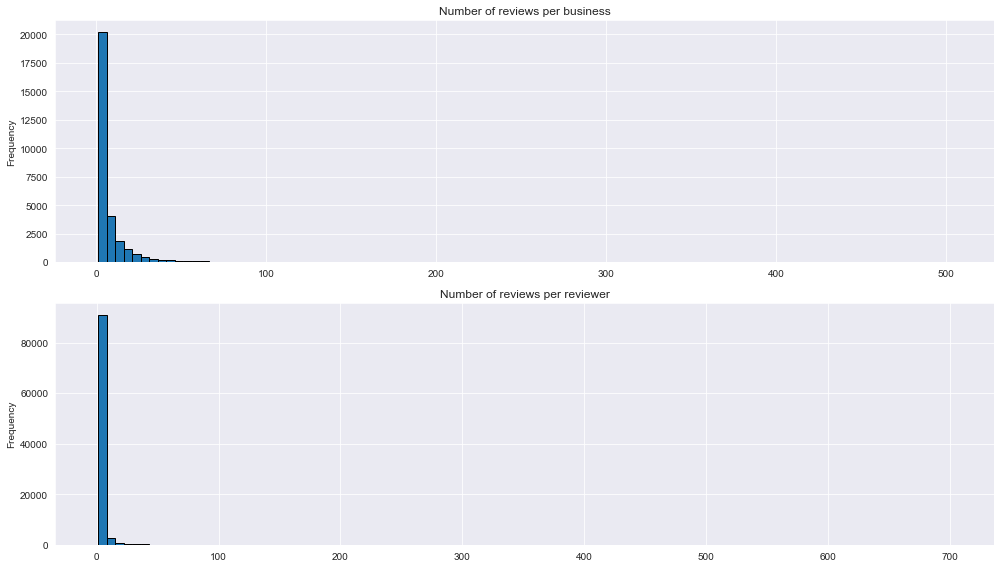

In [15]:
fig, ax = plt.subplots(2,1, figsize=(14,8))

reviews.gPlusPlaceId.value_counts().plot.hist(bins=100, edgecolor="black", ax=ax[0])
reviews.gPlusUserId.value_counts().plot.hist(bins=100, edgecolor="black", ax=ax[1])

ax[0].set_title("Number of reviews per business")
ax[1].set_title("Number of reviews per reviewer");
fig.tight_layout()

A lot of businesses only have a handful reviews but we have a couple businesses with 500+ reviews. Same goes for the number of reviews each reviewer has made, where some reviewers have made above 700 reviews.

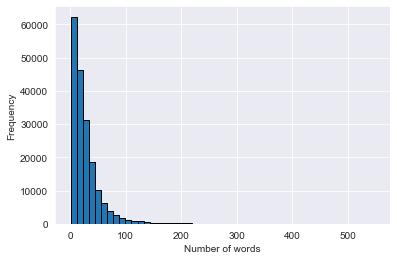

In [16]:
# Det her plot skal vi måske først bruge når vi laver NLP modellen
review_hist = reviews.dropna(subset=["reviewTextClean"]).reviewTextClean.apply(lambda x: len(x.split(" "))).plot.hist(bins=50, edgecolor="black")
review_hist.set_xlabel("Number of words");

## 1.3 Data Cleaning

- Remove zero rating reviews
- Gather categories to broader ones
    - e.g. European Restaurant, American Restaurant, Restaurant are all Restaurant

### Adding Sentiment to Reviews

Adding positive, negative and neutral scores to the review dataframe

In [153]:
import numpy as np
import math
import time
from tqdm import tqdm

In [18]:
reviews.head()

,rating,reviewerName,reviewText,gPlusPlaceId,gPlusUserId,reviewTextClean
0,3.0,elicia richardson-ellis,This is a very cute hotel with good amenities ...,106689630448064755324,100000340778638927606,cute hotel good amenity nice location great cr...
1,4.0,elicia richardson-ellis,Love this place. The Great/Good: Massage an...,108256990636148259283,100000340778638927606,love place massage facial technician best loun...
2,4.0,Nakamura Zen,NaN,104395160856690993217,100000469599933991939,NaN
3,4.0,Nakamura Zen,NaN,116090508615311611202,100000469599933991939,NaN
4,5.0,Yordanka Ilieva,Perfect service. The staff were very helpful.,111440664244734940136,100000520090706194742,perfect service staff helpful


In [97]:
reviews['reviewTextClean'][2]

nan

In [98]:
def isnan(string):
    return string != string
isnan(reviews['reviewTextClean'][2])

True

In [79]:
import requests
url = "https://text-sentiment.p.rapidapi.com/analyze"

payload = "text=" + reviews['reviewText'][0]

headers = {
    'content-type': "application/x-www-form-urlencoded",
    'x-rapidapi-host': "text-sentiment.p.rapidapi.com",
    'x-rapidapi-key': "69fc4436cemsh1a203c1a92ce0b9p176071jsnb263b5b48cd9"
    }
response = requests.request("POST", url, data=payload, headers=headers).json()



In [80]:
response

{'text': "This is a very cute hotel with good amenities and a nice location.  What is not so great is the cranky cocktail staff in the hotel bar on the second floor.  Ugh.  The last thing I need when I'm trying to unwind is a tightly wound, sour cocktail waitress delivering my $18 drink.",
 'totalLines': 4,
 'pos': 2,
 'neg': 0,
 'mid': 2,
 'pos_percent': '50%',
 'neg_percent': '0%',
 'mid_percent': '50%',
 'lang': 'ENGLISH'}

In [69]:
response['pos_percent']

'36.36363636363637%'

In [109]:
reviews['posReviewPercent'] = np.nan
reviews['negReviewPercent'] = np.nan
reviews['midReviewPercent'] = np.nan

In [110]:
reviews.head()

,rating,reviewerName,reviewText,gPlusPlaceId,gPlusUserId,reviewTextClean,posReviewPercent,negReviewPercent,midReviewPercent
0,3.0,elicia richardson-ellis,This is a very cute hotel with good amenities ...,106689630448064755324,100000340778638927606,cute hotel good amenity nice location great cr...,NaN,NaN,NaN
1,4.0,elicia richardson-ellis,Love this place. The Great/Good: Massage an...,108256990636148259283,100000340778638927606,love place massage facial technician best loun...,NaN,NaN,NaN
2,4.0,Nakamura Zen,NaN,104395160856690993217,100000469599933991939,NaN,NaN,NaN,NaN
3,4.0,Nakamura Zen,NaN,116090508615311611202,100000469599933991939,NaN,NaN,NaN,NaN
4,5.0,Yordanka Ilieva,Perfect service. The staff were very helpful.,111440664244734940136,100000520090706194742,perfect service staff helpful,NaN,NaN,NaN


In [154]:
i = 0
for r in tqdm(reviews['reviewText']):
    if isnan(r):
        i += 1
        pass
    else:
        try:
            
            url = "https://text-sentiment.p.rapidapi.com/analyze"
            payload = "text=" + r
            payload = payload.encode("utf-8")

            headers = {
                'content-type': "application/x-www-form-urlencoded",
                'x-rapidapi-host': "text-sentiment.p.rapidapi.com",
                'x-rapidapi-key': "69fc4436cemsh1a203c1a92ce0b9p176071jsnb263b5b48cd9"
                }
            response = requests.request("POST", url, data=payload, headers=headers).json()
            #print(response)
            reviews['posReviewPercent'][i] = response['pos_percent']
            reviews['negReviewPercent'][i] = response['neg_percent']
            reviews['midReviewPercent'][i] = response['mid_percent']

            i += 1
            
        except:
            i += 1
        
        #if i % 20 == 0:
            time.sleep(5)
    #if i == 16:
    #    break

  0%|                                                                                       | 0/257122 [00:00<?, ?it/s]<ipython-input-154-dafa987f363b>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reviews['posReviewPercent'][i] = response['pos_percent']
<ipython-input-154-dafa987f363b>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reviews['negReviewPercent'][i] = response['neg_percent']
<ipython-input-154-dafa987f363b>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

KeyboardInterrupt: 

In [147]:
i

51

In [148]:
response

{'status': 100, 'errormsg': 'Failed to parse text in form param'}

In [140]:
reviews['reviewText'][51]

'Glitzy Decor and Really Good Cocktails - but when an establishment is called STK - I expect it to serve good "Steak". £33 for a 400Gm Ribeye is 20% more expensive than the best steaks in London (H & G) - but after 2 tries they couldn\'t do a Medium-Rare correctly.'

In [138]:
reviews.loc[51]

rating                                                            2.0
reviewerName                                          Mitesh Shanbhag
reviewText          Glitzy Decor and Really Good Cocktails - but w...
gPlusPlaceId                                    101711411749560626204
gPlusUserId                                     100002870366309555032
reviewTextClean     glitzy decor really good cocktail establishmen...
posReviewPercent                                                  NaN
negReviewPercent                                                  NaN
midReviewPercent                                                  NaN
Name: 51, dtype: object

In [135]:
reviews

,rating,reviewerName,reviewText,gPlusPlaceId,gPlusUserId,reviewTextClean,posReviewPercent,negReviewPercent,midReviewPercent
0,3.0,elicia richardson-ellis,This is a very cute hotel with good amenities ...,106689630448064755324,100000340778638927606,cute hotel good amenity nice location great cr...,50%,0%,50%
1,4.0,elicia richardson-ellis,Love this place. The Great/Good: Massage an...,108256990636148259283,100000340778638927606,love place massage facial technician best loun...,100%,0%,0%
2,4.0,Nakamura Zen,NaN,104395160856690993217,100000469599933991939,NaN,NaN,NaN,NaN
3,4.0,Nakamura Zen,NaN,116090508615311611202,100000469599933991939,NaN,NaN,NaN,NaN
4,5.0,Yordanka Ilieva,Perfect service. The staff were very helpful.,111440664244734940136,100000520090706194742,perfect service staff helpful,100%,0%,0%
...,...,...,...,...,...,...,...,...,...
257117,2.0,Bruno Orsini,"used to be better. service is horrible, price ...",114598669582568454722,118446627871409499434,used better service horrible price good food s...,NaN,NaN,NaN
257118,4.0,Bruno Orsini,NaN,115393413807091201685,118446627871409499434,NaN,NaN,NaN,NaN
257119,4.0,Bruno Orsini,NaN,115740012747676843252,118446627871409499434,NaN,NaN,NaN,NaN
257120,4.0,Bruno Orsini,NaN,116184585745702669719,118446627871409499434,NaN,NaN,NaN,NaN


## 1.4 Zone dataframe

Features
- Number of businesses in grid cell
- Number of reviews in grid cell
- Number of restaurants in each price range
- 